# Import Libraries

In [1]:
import numpy as np
import tensorflow as tf
import keras

Using TensorFlow backend.


In [2]:
import matplotlib.pyplot as plt
from PIL import Image
import cv2
import seaborn

import os


# Load Dataset :    noisy_image

#### - Load Noisy image ( targe image )

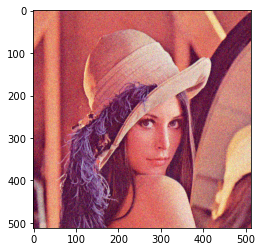

(<matplotlib.image.AxesImage at 0x1e350f5dac8>, None)

In [3]:
noisy_image_im = Image.open('../data/noisy.png')
noisy_image = np.array(noisy_image_im)/255.0

plt.imshow(noisy_image_im), plt.show()


# Setting NN models

#### - Setting the path of weights file

In [4]:
weights_paths = ['trained_models/epoch_100/', 'trained_models/epoch_100_early_stopping/']


#### - Check performance of prediction from trained model

In [5]:
def restore_image(trained_model, image):
    input_shape = (32,32,3)
    for row_idx in range(int(image.shape[0]/input_shape[0])):
        for col_idx in range(int(image.shape[1]/input_shape[1])):
            row_s = input_shape[0] * row_idx
            col_s = input_shape[1] * col_idx
            row_e = row_s + input_shape[0]
            col_e = col_s + input_shape[1]
            image_slice = image[row_s:row_e, col_s:col_e,:]
            
            
            restored_slice = trained_model.predict(np.array([image_slice]))[0]
            if col_idx == 0:
                restored_partition = restored_slice
            else:
                restored_partition = np.concatenate((restored_partition, restored_slice), axis=1)

        if row_idx == 0:
            restored_image = restored_partition
        else:
            restored_image = np.concatenate((restored_image, restored_partition), axis=0)
                
    return restored_image
        

## a) Model #1

#### - Build model

In [6]:
model_core = tf.keras.models.Sequential([
    tf.keras.layers.Conv2D(64, (3,3), input_shape=(32,32,3), padding='same', activation=tf.nn.relu),
    tf.keras.layers.Conv2D(64, (3,3), padding='same', activation=tf.nn.relu),
    tf.keras.layers.Conv2D(64, (3,3), padding='same', activation=tf.nn.relu),
    tf.keras.layers.Conv2D(64, (3,3), padding='same', activation=tf.nn.relu),
    tf.keras.layers.Conv2D(3, (3,3), padding='same')
])


#### - Show results

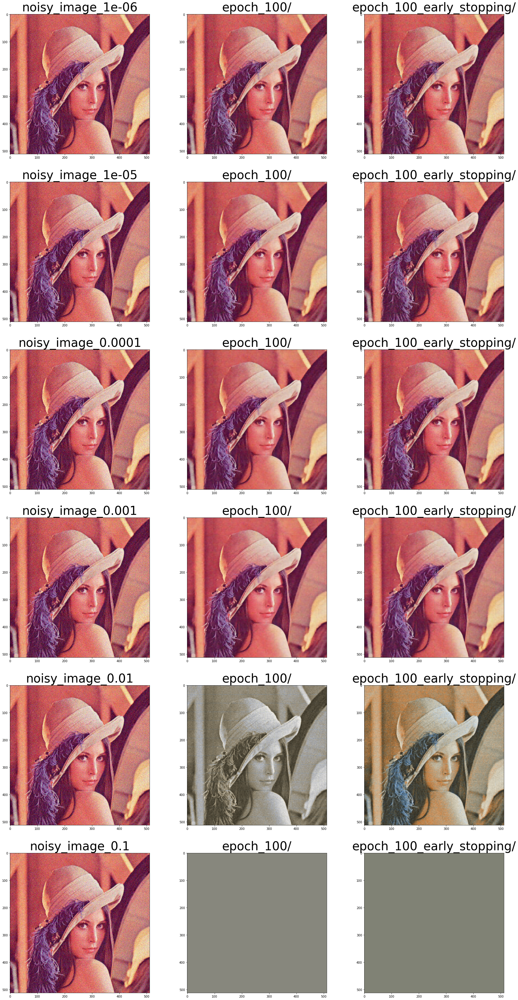

In [7]:
fig = plt.figure(figsize=(30,60))

for idx_lr, lr in enumerate([1e-6, 1e-5, 1e-4, 1e-3, 1e-2, 1e-1]):
    ax = fig.add_subplot(6,3, idx_lr*3 + 1)
    ax.imshow(noisy_image_im), ax.set_title('noisy_image_'+str(lr), fontsize=40)

    for idx_w, weights_path in enumerate(weights_paths):
        # load model
        model_core.load_weights(weights_path + str(lr) + '/model1.hdf5')

        # predict
        restored_image = restore_image(model_core, noisy_image)

        # convert to uint8 format
        restored_image *= 255.0
        restored_image = restored_image.astype(np.uint8)

        # save it
        image_name = weights_path+str(lr)+'/Model1.png'
        restored_image_im = Image.fromarray(restored_image)
        restored_image_im.save(image_name)
        
        ax = fig.add_subplot(6,3, idx_lr*3 + idx_w+2)
        ax.imshow(restored_image_im), ax.set_title(weights_path[15:], fontsize=40)


In [8]:
fig.savefig('result1.jpeg')

### Model #2

#### - Build model

In [9]:
model_core = tf.keras.models.Sequential([
    tf.keras.layers.Conv2D(64, (3,3), input_shape=(32,32,3), padding='same', activation=tf.nn.relu),
    tf.keras.layers.Conv2D(64, (3,3), padding='same', activation=tf.nn.relu),
    tf.keras.layers.Conv2D(64, (3,3), padding='same', activation=tf.nn.relu),
    tf.keras.layers.Conv2D(64, (3,3), padding='same', activation=tf.nn.relu),
    tf.keras.layers.Conv2D(3, (3,3), padding='same')
])


#### - Show results

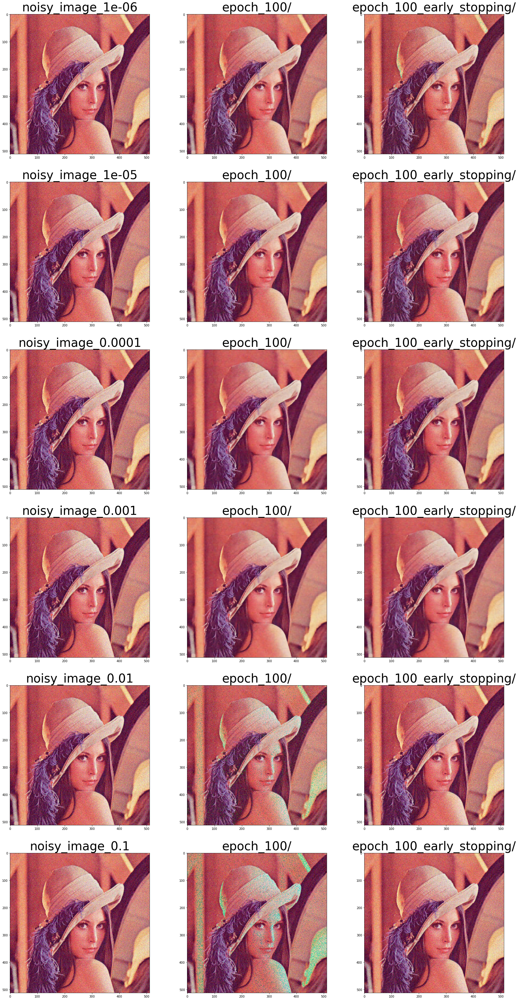

In [10]:
fig = plt.figure(figsize=(30,60))

for idx_lr, lr in enumerate([1e-6, 1e-5, 1e-4, 1e-3, 1e-2, 1e-1]):
    ax = fig.add_subplot(6,3, idx_lr*3 + 1)
    ax.imshow(noisy_image_im), ax.set_title('noisy_image_'+str(lr), fontsize=40)

    for idx_w, weights_path in enumerate(weights_paths):
        # load model
        model_core.load_weights(weights_path + str(lr) + '/model2.hdf5')

        # predict
        restored_image = noisy_image + restore_image(model_core, noisy_image)

        # convert to uint8 format
        restored_image *= 255.0
        restored_image = restored_image.astype(np.uint8)

        # save it
        image_name = weights_path+str(lr)+'/Model2.png'
        restored_image_im = Image.fromarray(restored_image)
        restored_image_im.save(image_name)
        
        ax = fig.add_subplot(6,3, idx_lr*3 + idx_w+2)
        ax.imshow(restored_image_im), ax.set_title(weights_path[15:], fontsize=40)


In [11]:
fig.savefig('result2.jpeg')

### Model #3

#### - Build model

In [12]:
model_core = tf.keras.models.Sequential([
    tf.keras.layers.Conv2D(64, (3,3), input_shape=(32,32,3), padding='same'),
    tf.keras.layers.BatchNormalization(),
    tf.keras.layers.Activation('relu'),
    tf.keras.layers.Conv2D(64, (3,3), padding='same'),
    tf.keras.layers.BatchNormalization(),
    tf.keras.layers.Activation('relu'),
    tf.keras.layers.Conv2D(64, (3,3), padding='same'),
    tf.keras.layers.BatchNormalization(),
    tf.keras.layers.Activation('relu'),
    tf.keras.layers.Conv2D(64, (3,3), padding='same'),
    tf.keras.layers.BatchNormalization(),
    tf.keras.layers.Activation('relu'),    
    tf.keras.layers.Conv2D(3, (3,3), padding='same')
])


#### - Show results

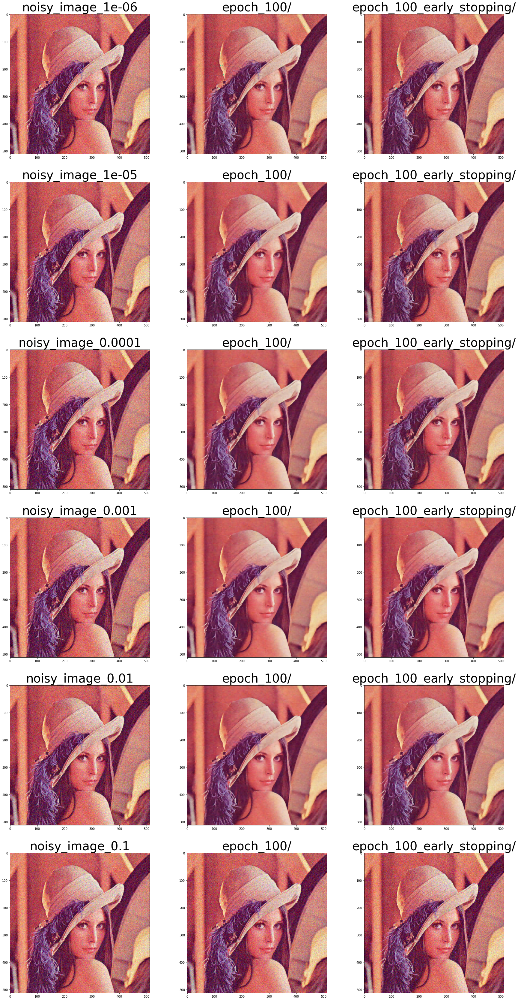

In [13]:
fig = plt.figure(figsize=(30,60))

for idx_lr, lr in enumerate([1e-6, 1e-5, 1e-4, 1e-3, 1e-2, 1e-1]):
    ax = fig.add_subplot(6,3, idx_lr*3 + 1)
    ax.imshow(noisy_image_im), ax.set_title('noisy_image_'+str(lr), fontsize=40)

    for idx_w, weights_path in enumerate(weights_paths):
        # load model
        model_core.load_weights(weights_path + str(lr) + '/model3.hdf5')

        # predict
        restored_image = noisy_image + restore_image(model_core, noisy_image)

        # convert to uint8 format
        restored_image *= 255.0
        restored_image = restored_image.astype(np.uint8)

        # save it
        image_name = weights_path+str(lr)+'/Model3.png'
        restored_image_im = Image.fromarray(restored_image)
        restored_image_im.save(image_name)
        
        ax = fig.add_subplot(6,3, idx_lr*3 + idx_w+2)
        ax.imshow(restored_image_im), ax.set_title(weights_path[15:], fontsize=40)


In [14]:
fig.savefig('result3.jpeg')

# Compare Results

- epoch 100 with no early-stopping
- learning rate : 1e-4


(<matplotlib.image.AxesImage at 0x1e526d31d48>, Text(0.5, 1.0, 'model3'))

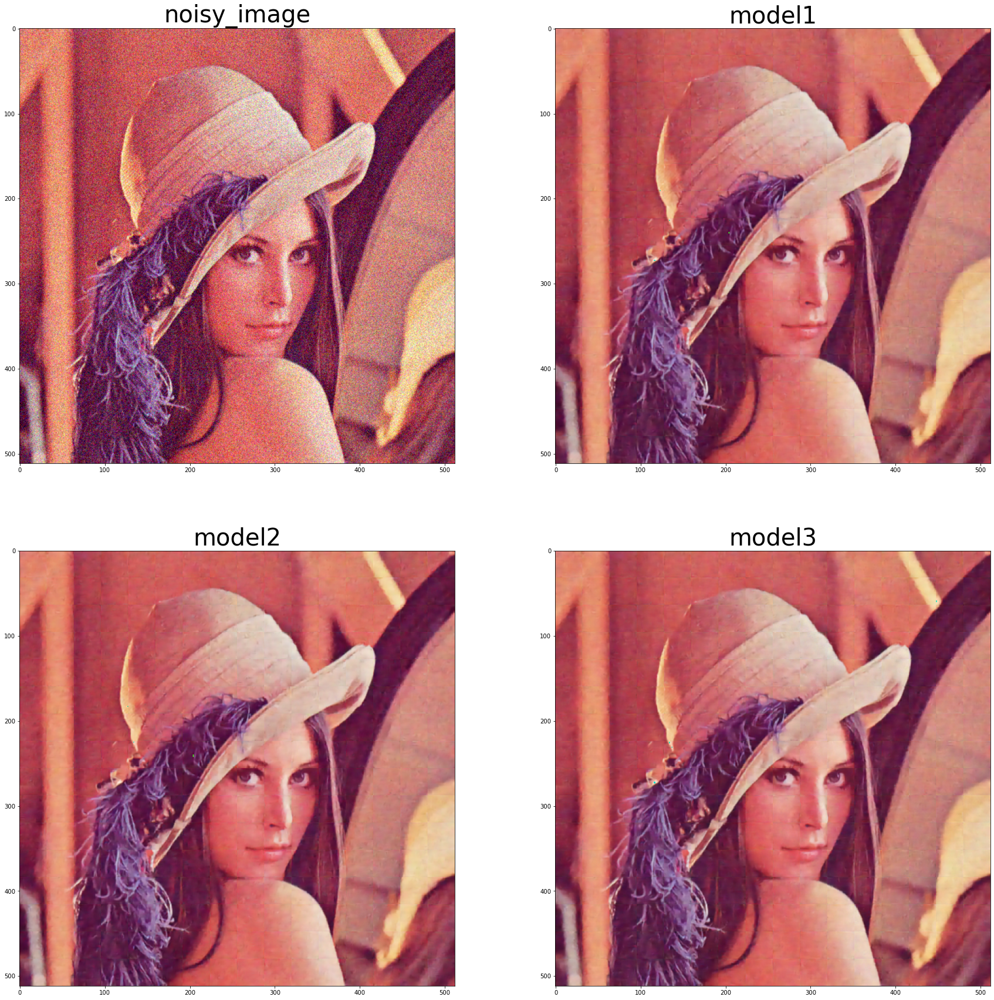

In [17]:
image_path = 'trained_models/epoch_100/'+str(1e-4)+'/'
restored_image_1 = Image.open(image_path+'Model1.png')
restored_image_2 = Image.open(image_path+'Model2.png')
restored_image_3 = Image.open(image_path+'Model3.png')

fig = plt.figure(figsize=(30,30))
ax1 = fig.add_subplot(2,2,1)
ax1.imshow(noisy_image), ax1.set_title('noisy_image', fontsize=40)
ax2 = fig.add_subplot(2,2,2)
ax2.imshow(restored_image_1), ax2.set_title('model1', fontsize=40)
ax3 = fig.add_subplot(2,2,3)
ax3.imshow(restored_image_2), ax3.set_title('model2', fontsize=40)
ax4 = fig.add_subplot(2,2,4)
ax4.imshow(restored_image_3), ax4.set_title('model3', fontsize=40)


In [18]:
fig.savefig('results.jpeg')